In [3]:
import zipfile as zf
files = zf.ZipFile("/content/n_data.zip", 'r')
files.extractall('my_data')
files.close()

In [4]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow
import matplotlib.pyplot as plt
import math
import os

In [5]:
# Input folder containing images
input_folder = '/content/my_data/n_data'

In [6]:
import os
# Output folder for cut-out objects
output_folder = '/content/cutout_objects'
os.makedirs(output_folder, exist_ok=True)

In [7]:
# Define the color range for object detection
lower_bound = np.array([0, 0, 0])
upper_bound = np.array([100, 100, 100])

In [8]:
for filename in os.listdir(input_folder):
    if filename.endswith('.JPG'):
        image_path = os.path.join(input_folder, filename)
        image = cv2.imread(image_path)

        # Create a mask for the object you want to cut out
        mask = cv2.inRange(image, lower_bound, upper_bound)

        # Find contours in the mask
        contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

        if contours:
            # Find the largest contour (assumed to be the object you want to cut out)
            largest_contour = max(contours, key=cv2.contourArea)

            # Create an empty mask for the object
            object_mask = np.zeros_like(mask)

            # Draw the largest contour on the object mask
            cv2.drawContours(object_mask, [largest_contour], -1, 255, thickness=cv2.FILLED)

            # Bitwise AND the object mask with the original image to get the cut-out object
            cutout = cv2.bitwise_and(image, image, mask=object_mask)

            # Create a white background image of the same size as the original image
            white_background = np.ones_like(image) * 255

            # Invert the object mask to get the background mask
            background_mask = cv2.bitwise_not(object_mask)

            # Combine the cutout object with the white background using the masks
            replaced_background = cv2.bitwise_and(white_background, white_background, mask=background_mask)
            replaced_background += cutout

            # Save the image with the replaced white background
            replaced_filename = f'replaced_{filename}'
            replaced_path = os.path.join(output_folder, replaced_filename)
            cv2.imwrite(replaced_path, replaced_background)

In [ ]:
# # Loop through all files in the input folder
# for filename in os.listdir(input_folder):
#     if filename.endswith('.JPG'):
#         image_path = os.path.join(input_folder, filename)
#         image = cv2.imread(image_path)

#         # Create a mask for the object you want to cut out
#         mask = cv2.inRange(image, lower_bound, upper_bound)

#         # Find contours in the mask
#         contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

#         if contours:
#             # Find the largest contour (assumed to be the object you want to cut out)
#             largest_contour = max(contours, key=cv2.contourArea)

#             # Create an empty mask for the object
#             object_mask = np.zeros_like(mask)

#             # Draw the largest contour on the object mask
#             cv2.drawContours(object_mask, [largest_contour], -1, 255, thickness=cv2.FILLED)

#             # Bitwise AND the object mask with the original image to get the cut-out object
#             cutout = cv2.bitwise_and(image, image, mask=object_mask)

#             # Save the cut-out object
#             cutout_filename = f'cutout_{filename}'
#             cutout_path = os.path.join(output_folder, cutout_filename)
#             cv2.imwrite(cutout_path, cutout)

#             # # Display the cut-out object using cv2_imshow() in Colab
#             # cv2_imshow(cutout)


In [9]:
# Load the segmented image
segmented_image = cv2.imread("/content/cutout_objects/replaced_DJI_0335.JPG")

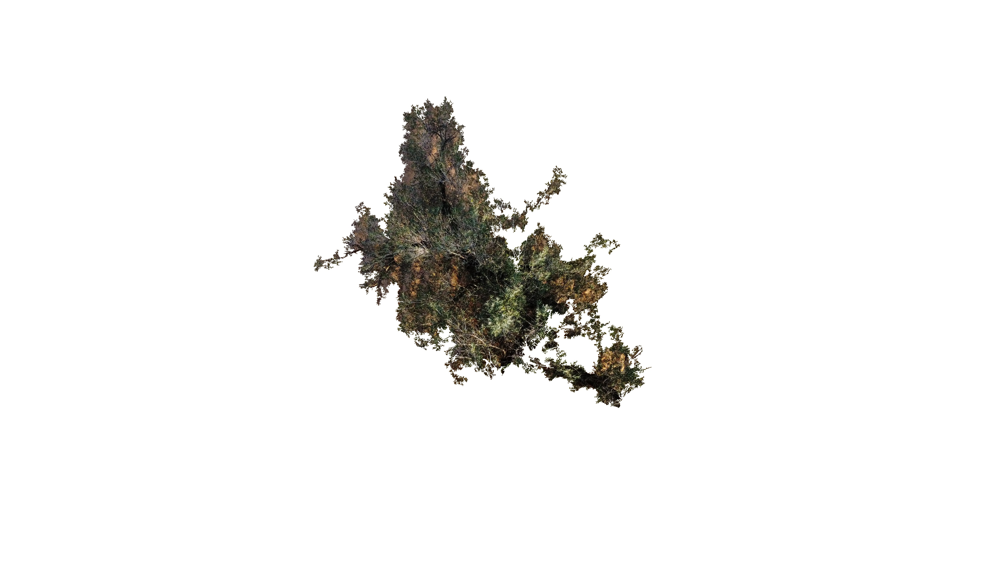

In [10]:
# Display the segmented image
cv2_imshow(segmented_image)

In [11]:
def calculate_soil_percentage(image_path):
    # Read the image
    image = cv2.imread(image_path)

    # Convert the image to the HSV color space
    hsv_image = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
    lower_bound = np.array([0, 50, 50])  # Lower bound of soil color in HSV
    upper_bound = np.array([30, 255, 255])
    # b_lower_bound = np.array([0, 0, 0])   # Adjust these values as needed
    # # b_upper_bound = np.array([180, 255, 40])  # Adjust these values as needed
    # b_upper_bound = np.array([0,0, 0])

    # Define a mask using the specified color range for black color
    # black_mask = cv2.inRange(hsv_image, b_lower_bound, b_upper_bound)
    # black_pixels = cv2.countNonZero(black_mask)
    # black_pixels = np.count_nonzero(segmented_image == 0)

    total_pixels = image.shape[0] * image.shape[1]

    # total_non_black_pixels = total_pixels - black_pixels

    # Define a mask using the specified color range for soil
    soil_mask = cv2.inRange(hsv_image, lower_bound, upper_bound)

    # Calculate the percentage of soil pixels

    soil_pixels = cv2.countNonZero(soil_mask)
    soil_percentage = (soil_pixels / total_pixels )

    return soil_mask, soil_percentage

In [17]:
def calculate_green_percentage(image_path):
    # Read the image
    image = cv2.imread(image_path)

    # Convert the image to the HSV color space
    hsv_image = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
    # lower_bound = np.array([0, 50, 50])  # Lower bound of soil color in HSV
    # upper_bound = np.array([30, 255, 255])
    green_pixels = np.count_nonzero((hsv_image>= 50) & (hsv_image <= 100))
    # b_lower_bound = np.array([0, 0, 0])   # Adjust these values as needed
    # # b_upper_bound = np.array([180, 255, 40])  # Adjust these values as needed
    # b_upper_bound = np.array([0,0, 0])

    # Define a mask using the specified color range for black color
    # black_mask = cv2.inRange(hsv_image, b_lower_bound, b_upper_bound)
    # black_pixels = cv2.countNonZero(black_mask)
    # black_pixels = np.count_nonzero(segmented_image == 0)

    total_pixels = image.shape[0] * image.shape[1]

    # total_non_black_pixels = total_pixels - black_pixels

    # Define a mask using the specified color range for soil
    # green_mask = cv2.inRange(hsv_image, lower_bound, upper_bound)

    # Calculate the percentage of soil pixels

    # green_pixels = cv2.countNonZero(green_mask)
    green_percentage = (green_pixels / total_pixels)

    return green_percentage

In [13]:
# Load the segmented image
segmented_image_gray = cv2.cvtColor(segmented_image, cv2.COLOR_BGR2GRAY)

In [14]:
# Define the square size
square_size = 50

In [15]:
# Initialize variables for total and count
total_sol_percentage = 0
total_feuil_percentage = 0
square_count = 0

Image: replaced_DJI_0341.JPG
image statistic
Sol percentage in image: 3.44%
LAI percentage in image: 6.99%
feuil percentage in image: 6.71%
black percentage in image: 82.86%
image statistic using frames
Average Soil percentage of frames: 23.21%
Average LAI percentage of frames: 59.38%
Average Feuil percentage of frames: 31.05%
Average Black percentage of frames: 0.13%
Accuracy equal : 99.54%
number of frame: 374.00%


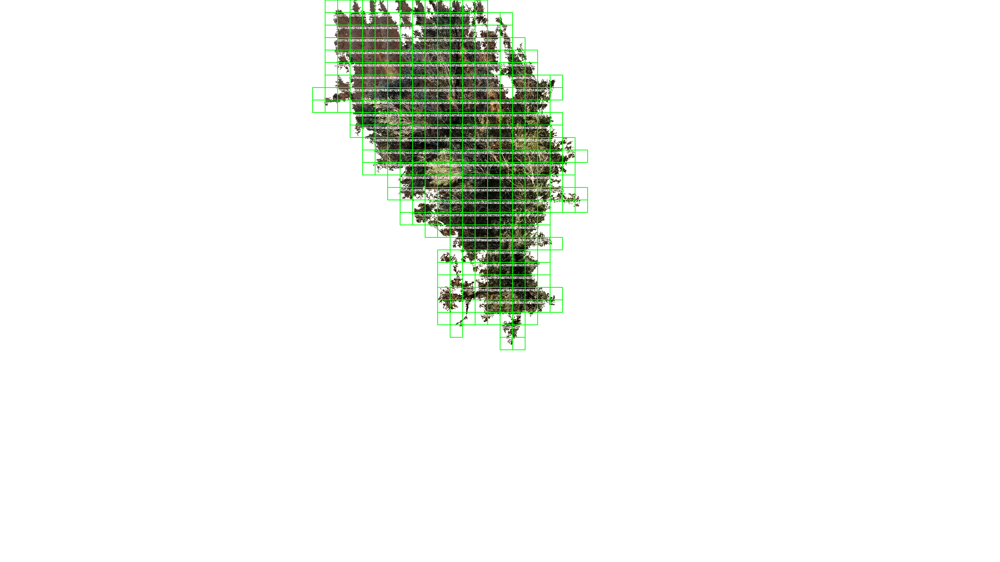

Image: replaced_DJI_0335.JPG
image statistic
Sol percentage in image: 2.69%
LAI percentage in image: 5.44%
feuil percentage in image: 6.06%
black percentage in image: 85.81%
image statistic using frames
Average Soil percentage of frames: 22.19%
Average LAI percentage of frames: 55.27%
Average Feuil percentage of frames: 29.60%
Average Black percentage of frames: 0.12%
Accuracy equal : 99.52%
number of frame: 744.00%


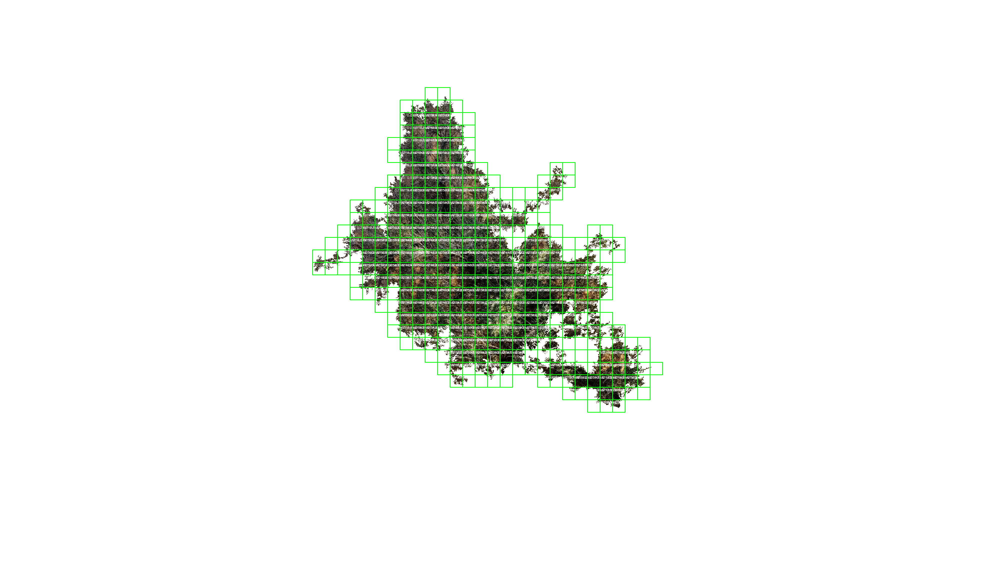

Image: replaced_DJI_0344.JPG
image statistic
Sol percentage in image: 3.50%
LAI percentage in image: 7.13%
feuil percentage in image: 6.40%
black percentage in image: 82.97%
image statistic using frames
Average Soil percentage of frames: 22.24%
Average LAI percentage of frames: 54.71%
Average Feuil percentage of frames: 30.12%
Average Black percentage of frames: 0.09%
Accuracy equal : 99.52%
number of frame: 1097.00%


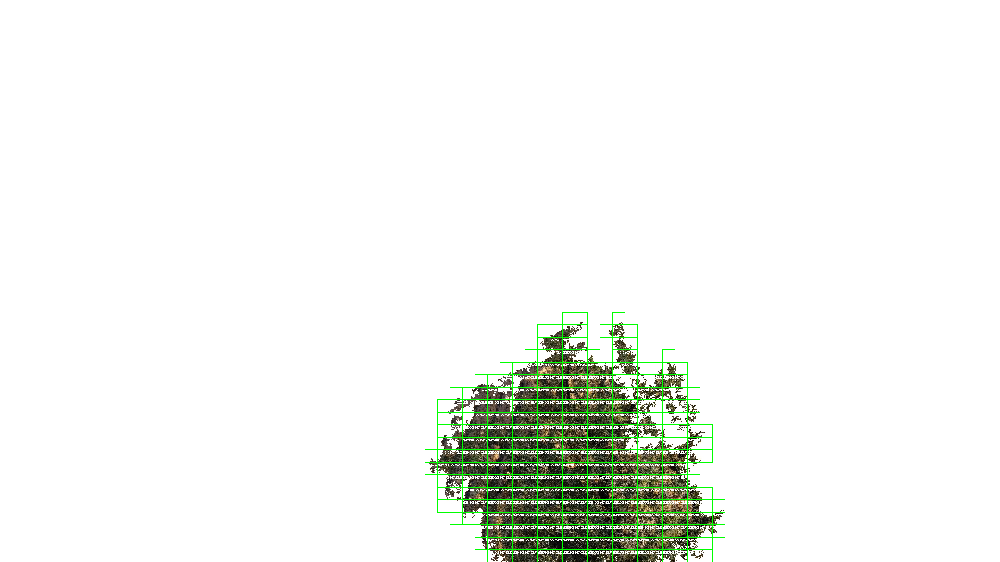

Image: replaced_DJI_0345.JPG
image statistic
Sol percentage in image: 4.26%
LAI percentage in image: 8.71%
feuil percentage in image: 7.26%
black percentage in image: 79.77%
image statistic using frames
Average Soil percentage of frames: 22.37%
Average LAI percentage of frames: 54.87%
Average Feuil percentage of frames: 29.91%
Average Black percentage of frames: 0.08%
Accuracy equal : 99.52%
number of frame: 1531.00%


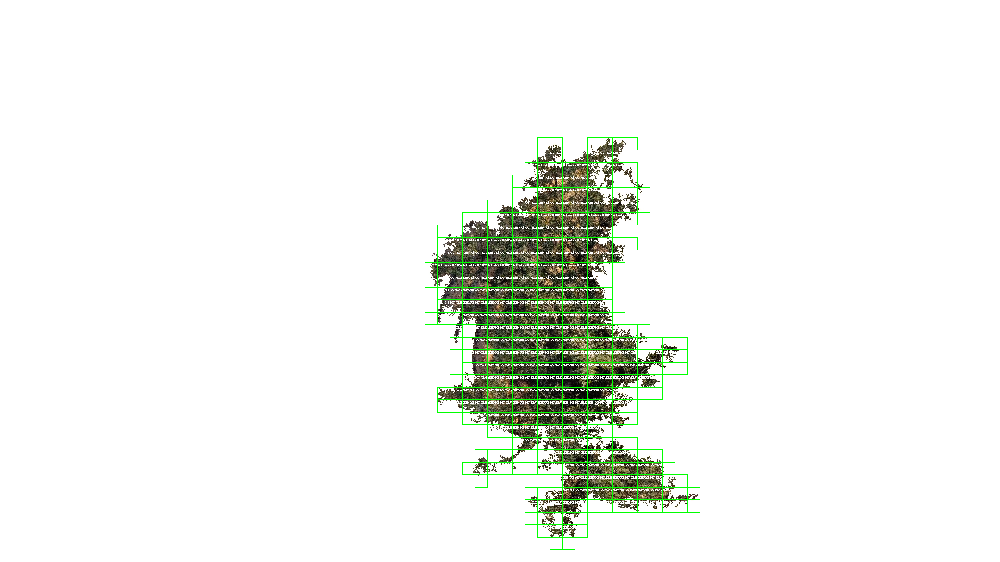

Image: replaced_DJI_0325.JPG
image statistic
Sol percentage in image: 2.10%
LAI percentage in image: 4.24%
feuil percentage in image: 3.39%
black percentage in image: 90.27%
image statistic using frames
Average Soil percentage of frames: 21.51%
Average LAI percentage of frames: 52.39%
Average Feuil percentage of frames: 29.12%
Average Black percentage of frames: 0.09%
Accuracy equal : 99.51%
number of frame: 1778.00%


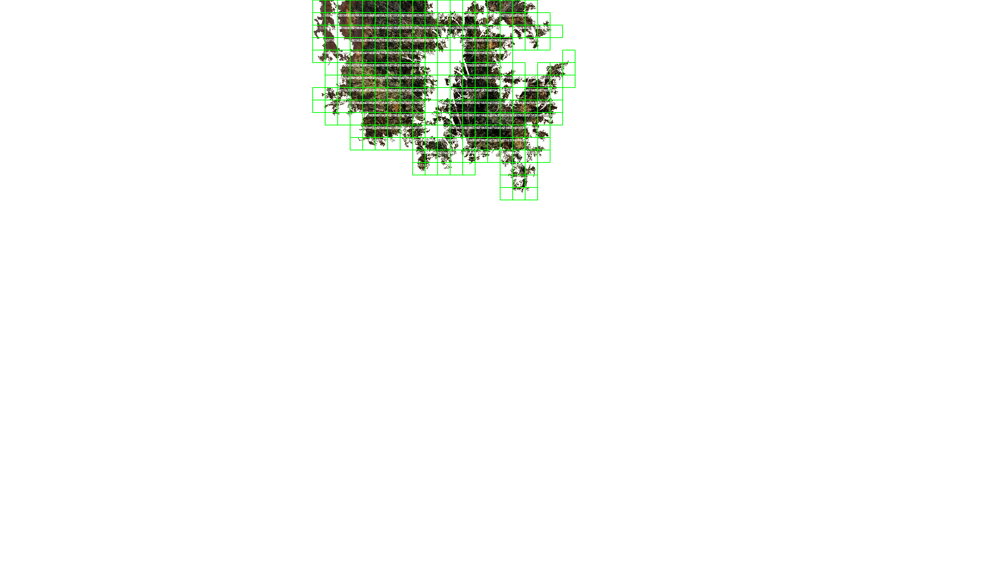

Image: replaced_DJI_0331.JPG
image statistic
Sol percentage in image: 0.83%
LAI percentage in image: 1.68%
feuil percentage in image: 1.35%
black percentage in image: 96.14%
image statistic using frames
Average Soil percentage of frames: 21.33%
Average LAI percentage of frames: 51.92%
Average Feuil percentage of frames: 29.09%
Average Black percentage of frames: 0.09%
Accuracy equal : 99.51%
number of frame: 1872.00%


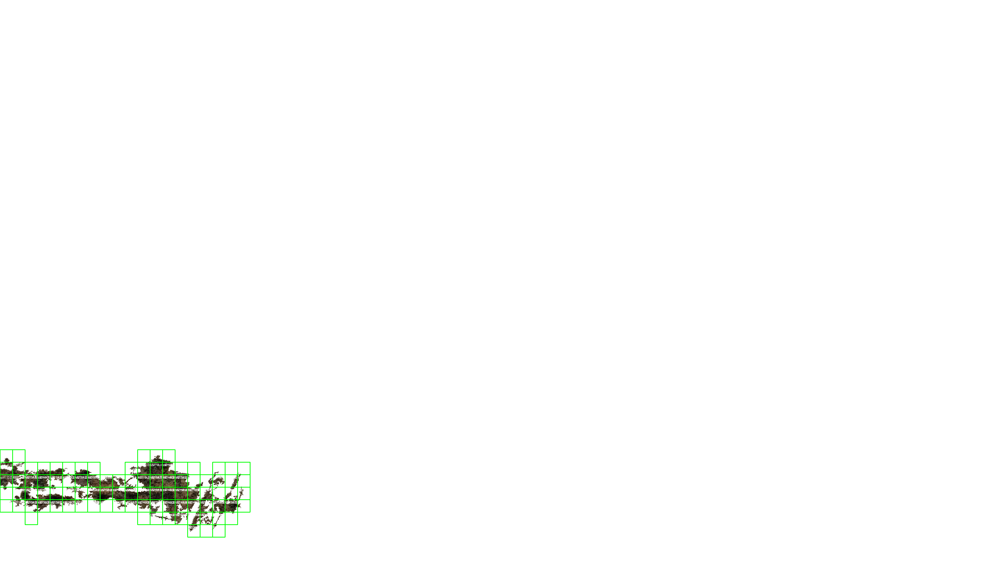

Image: replaced_DJI_0314.JPG
image statistic
Sol percentage in image: 6.22%
LAI percentage in image: 12.85%
feuil percentage in image: 8.38%
black percentage in image: 72.55%
image statistic using frames
Average Soil percentage of frames: 20.69%
Average LAI percentage of frames: 49.91%
Average Feuil percentage of frames: 28.87%
Average Black percentage of frames: 0.08%
Accuracy equal : 99.50%
number of frame: 2420.00%


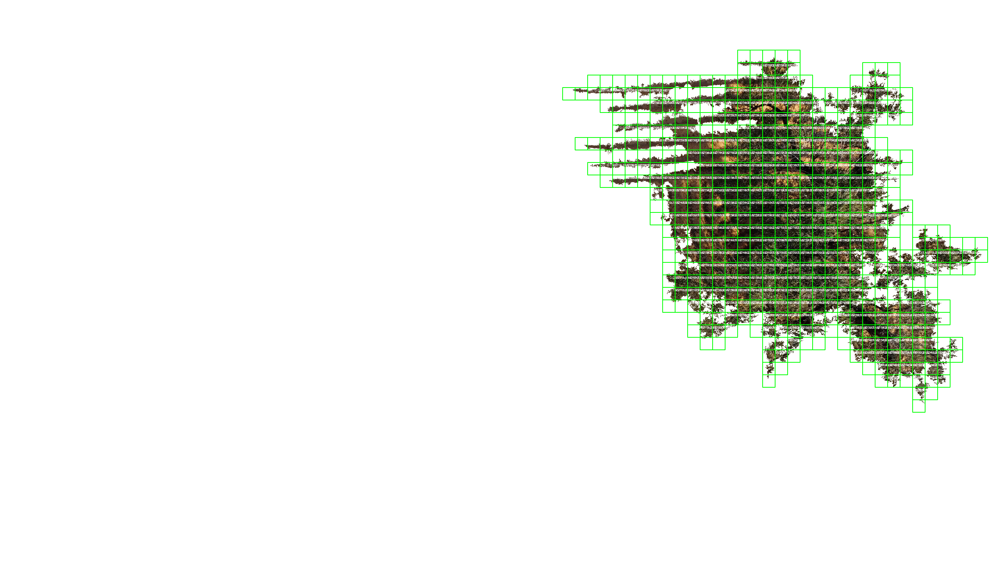

Image: replaced_DJI_0336.JPG
image statistic
Sol percentage in image: 2.36%
LAI percentage in image: 4.77%
feuil percentage in image: 4.35%
black percentage in image: 88.52%
image statistic using frames
Average Soil percentage of frames: 20.39%
Average LAI percentage of frames: 49.03%
Average Feuil percentage of frames: 28.57%
Average Black percentage of frames: 0.08%
Accuracy equal : 99.49%
number of frame: 2703.00%


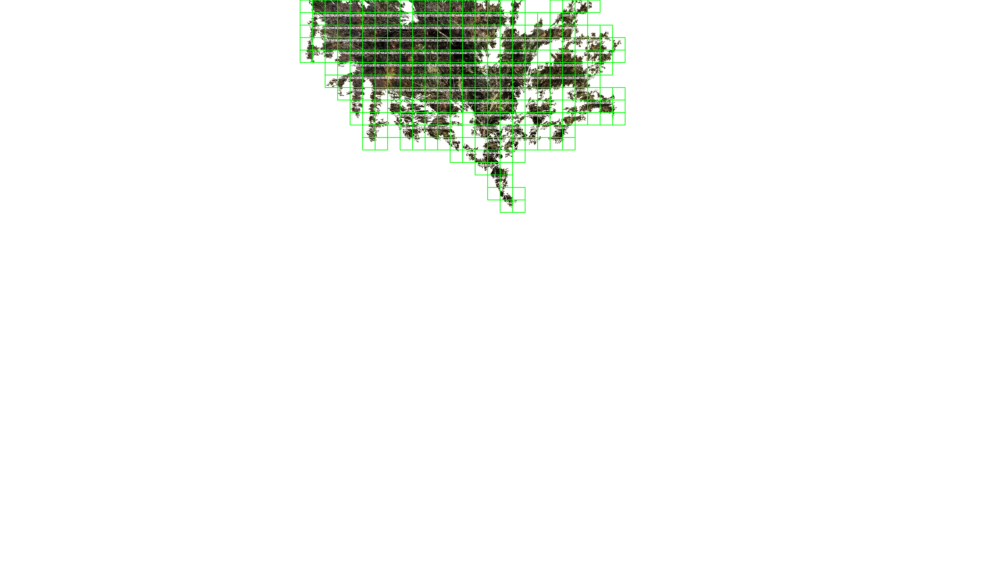

Image: replaced_DJI_0346.JPG
image statistic
Sol percentage in image: 3.89%
LAI percentage in image: 7.93%
feuil percentage in image: 6.77%
black percentage in image: 81.41%
image statistic using frames
Average Soil percentage of frames: 20.53%
Average LAI percentage of frames: 49.38%
Average Feuil percentage of frames: 28.54%
Average Black percentage of frames: 0.07%
Accuracy equal : 99.49%
number of frame: 3116.00%


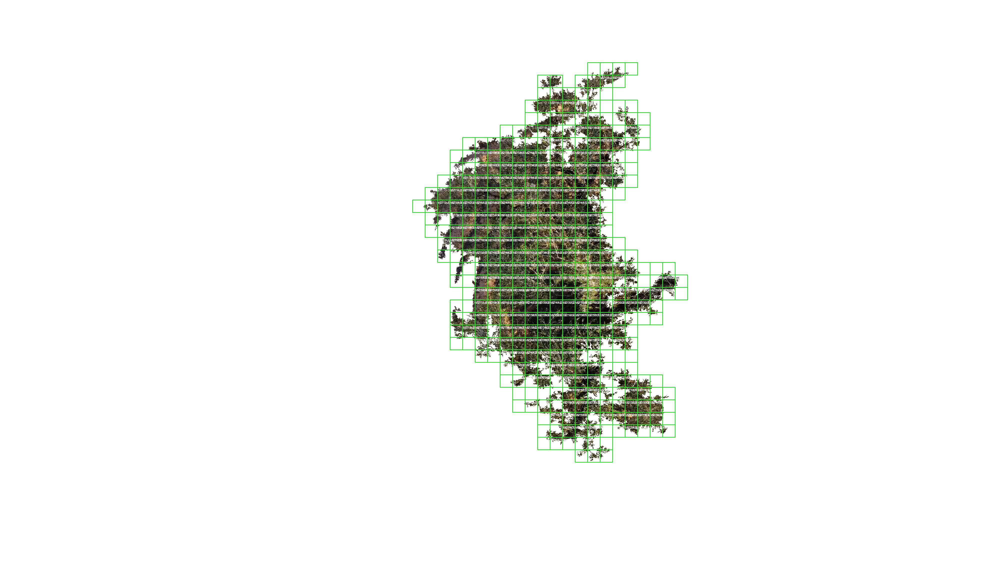

Image: replaced_DJI_0340.JPG
image statistic
Sol percentage in image: 2.75%
LAI percentage in image: 5.57%
feuil percentage in image: 6.54%
black percentage in image: 85.14%
image statistic using frames
Average Soil percentage of frames: 20.32%
Average LAI percentage of frames: 48.78%
Average Feuil percentage of frames: 28.23%
Average Black percentage of frames: 0.08%
Accuracy equal : 99.49%
number of frame: 3529.00%


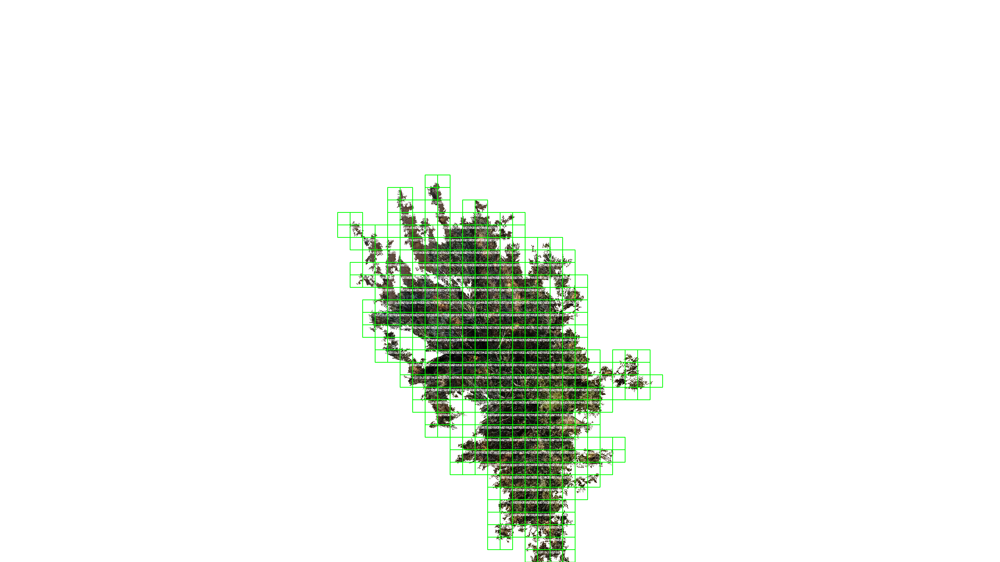

In [18]:

image_folder = "/content/cutout_objects"  # Replace with the path to your image folder

total_sol_percentage = 0
total_feuil_percentage = 0
total_black_percentage = 0
total_lai_percentage = 0
square_count = 0
#     # Define the color range for soil in BGR format
# lower_bound = np.array([0, 50, 50])  # Lower bound of soil color in HSV
# upper_bound = np.array([30, 255, 255])  # Upper bound of soil color in HSV


for filename in os.listdir(image_folder):
        if filename.endswith(".JPG"):  # Adjust the file extension as needed
            image_path = os.path.join(image_folder, filename)

            soil_mask,soil_percentage = calculate_soil_percentage(image_path)
            # black_percentage = calculate_black_percentage(image_path)
            green_percentage = calculate_green_percentage(image_path)

            lai = -2 * math.log(1 - soil_percentage)  # LAI = -2 * ln(1 - Soil%)


            # Load the image
            image = cv2.imread(image_path)
            segmented_image = image.copy()
            segmented_image_gray = cv2.cvtColor(segmented_image, cv2.COLOR_BGR2GRAY)

            # Create a copy of the segmented_image for visualization
            visualized_image = segmented_image.copy()



            # Iterate over the image in steps of square_size
            for y in range(0, segmented_image.shape[0], square_size):
                for x in range(0, segmented_image.shape[1], square_size):
                    square = segmented_image_gray[y:y+square_size, x:x+square_size]

                    # Calculate feuil (percentage of green pixels in the square)
                    green_pixels = np.count_nonzero((square >= 50) & (square <= 100))  # Example green range


                    black_pixels = np.count_nonzero((square == 0 ))

                    soil_pixels = np.count_nonzero((square >= 70) & (square <= 120))  # Example green range
                    # soil_pixels = np.count_nonzero((square > 100) & (square <= 120))
                    # soil_pixels = np.count_nonzero(np.all((square >= soil_lower_bound) & (square <= soil_upper_bound), axis=2))
                    black_percentage = (black_pixels / (square_size * square_size))

                    sol_percentage = (soil_pixels / (square_size * square_size))   # SOL calculation
                    lai_percentage = -2 * math.log(1-sol_percentage)  # Feuil calculation
                    feuil_percentage = (green_pixels / (square_size * square_size))

                    if green_pixels > 0:  # Only calculate sol if there are green pixels in the square
                    # sol_percentage = np.exp(-0.5 * feuil_percentage)

                    # Accumulate values for total and count
                      total_sol_percentage += sol_percentage
                      total_lai_percentage += lai_percentage
                      total_feuil_percentage += feuil_percentage
                      total_black_percentage += black_percentage
                      square_count += 1

                      # Draw rectangle around the square on the visualized image
                      top_left = (x, y)
                      bottom_right = (x + square_size, y + square_size)
                      color = (0, 255, 0)  # Green color for rectangles
                      thickness = 2  # Thickness of the rectangle
                      cv2.rectangle(visualized_image, top_left, bottom_right, color, thickness)

                      # Display sol and feuil values on the visualized image
                      text = f"sol: {sol_percentage:.2f}%\nfeuil: {feuil_percentage:.2f}%"
                      text_position = (x, y + square_size + 15)
                      font = cv2.FONT_HERSHEY_SIMPLEX
                      font_scale = 0.4
                      font_color = (255, 255, 255)  # White color for text
                      cv2.putText(visualized_image, text, text_position, font, font_scale, font_color, thickness=1)

            # Calculate the averages
            average_sol_percentage = total_sol_percentage / square_count if square_count > 0 else 0
            average_feuil_percentage = total_feuil_percentage / square_count if square_count > 0 else 0
            average_black_percentage = total_black_percentage / square_count if square_count > 0 else 0
            average_lai_percentage = total_lai_percentage / square_count if square_count > 0 else 0

            # Print the totals and averages
            print(f"Image: {filename}")
            print("="*45)

            print("image statistic")

            print(f"Sol percentage in image: {soil_percentage*100:.2f}%")
            print(f"LAI percentage in image: {lai*100:.2f}%")
            print(f"feuil percentage in image: {green_percentage*100:.2f}%")
            print(f"black percentage in image: {(1-(soil_percentage+lai+green_percentage)) *100:.2f}%")
            print("="*45)
            # print(f"Black percentage in image: {black_percentage*100:.2f}%")
            print("image statistic using frames")

            print(f"Average Soil percentage of frames: {average_sol_percentage*100:.2f}%")
            print(f"Average LAI percentage of frames: {average_lai_percentage*100:.2f}%")
            print(f"Average Feuil percentage of frames: {average_feuil_percentage*100:.2f}%")
            print(f"Average Black percentage of frames: {average_black_percentage*100:.2f}%")
            print(f"Accuracy equal : {100-(1-(average_black_percentage+average_feuil_percentage+average_sol_percentage)):.2f}%")

            print(f"number of frame: {square_count:.2f}%")


            # Display the visualized image
            cv2_imshow(visualized_image)


            print("=" * 45)
            print("=" *45)


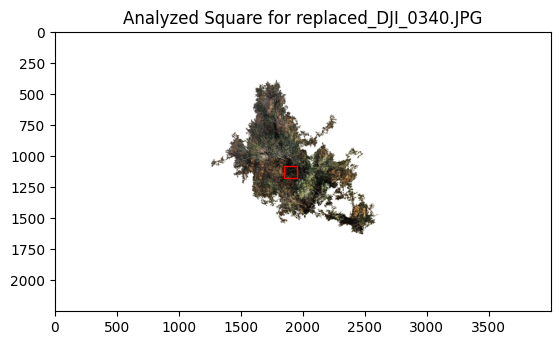

Image: replaced_DJI_0340.JPG
Soil percentage: 19.27%
Estimated LAI percentage: 42.81
green percentage: 36.17
BLACK percentage: 16.21


In [37]:

image_folder="/content/cutout_objects/replaced_DJI_0335.JPG"
# Load the image for the square-based calculations
image = cv2.imread(image_folder)
segmented_image = image.copy()
segmented_image_gray = cv2.cvtColor(segmented_image, cv2.COLOR_BGR2GRAY)

square_size=100
# Create a copy of the segmented_image for visualization
visualized_image = segmented_image.copy()
#=====================================================================
# we work about small square ((fram)) for the visualisation
#=====================================================================

# Extract the central square for analysis
y_center = segmented_image.shape[0] // 2
x_center = segmented_image.shape[1] // 2
y_start = y_center - square_size // 2
x_start = x_center - square_size -100 // 2
square = segmented_image[y_start:y_start+square_size, x_start:x_start+square_size]

# green_pixels = np.count_nonzero((square >= 50) & (square <= 100))  # COLOR range

black_pixels = np.count_nonzero((square == 0 ))

soil_pixels = np.count_nonzero((square >= 70) & (square <= 120))  # COLOR range

black_percentage = (black_pixels / (square_size * square_size))

soil_percentage = (soil_pixels / (square_size * square_size))  # SOL calculation
lai = (-2) * math.log(1-soil_percentage)  # Feuil calculation
green_pixels = np.count_nonzero((square >= 50) & (square <= 100))
green = (green_pixels / (square_size * square_size))

# Display the image and draw a rectangle around the analyzed square
plt.imshow(cv2.cvtColor(segmented_image, cv2.COLOR_BGR2RGB))
rect = plt.Rectangle((x_start, y_start), square_size, square_size, fill=False, color='red')
plt.gca().add_patch(rect)
plt.title(f"Analyzed Square for {filename}")
plt.show()
print(f"Image: {filename}")
print(f"Soil percentage: {soil_percentage*100:.2f}%")
print(f"Estimated LAI percentage: {lai*100:.2f}")
print(f"green percentage: {green*100:.2f}")
print(f"BLACK percentage: {black_percentage*100:.2f}")
print("=" * 40)